# Traffic Prediction DL - OpenGenius

## Imports

In [3]:
import numpy as np
import pandas as pd 
import matplotlib.pyplot as plt
from matplotlib.ticker import MaxNLocator  
from sklearn.model_selection import train_test_split 
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense
from tensorflow.keras.callbacks import EarlyStopping

/opt/conda/lib/python3.10/site-packages/scipy/__init__.py:146: UserWarning: A NumPy version >=1.16.5 and <1.23.0 is required for this version of SciPy (detected version 1.23.5
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"
/opt/conda/lib/python3.10/site-packages/tensorflow_io/python/ops/__init__.py:98: UserWarning: unable to load libtensorflow_io_plugins.so: unable to open file: libtensorflow_io_plugins.so, from paths: ['/opt/conda/lib/python3.10/site-packages/tensorflow_io/python/ops/libtensorflow_io_plugins.so']
caused by: ['/opt/conda/lib/python3.10/site-packages/tensorflow_io/python/ops/libtensorflow_io_plugins.so: undefined symbol: _ZN3tsl6StatusC1EN10tensorflow5error4CodeESt17basic_string_viewIcSt11char_traitsIcEENS_14SourceLocationE']
  warnings.warn(f"unable to load libtensorflow_io_plugins.so: {e}")
/opt/conda/lib/python3.10/site-packages/tensorflow_io/python/ops/__init__.py:104: UserWarning: file system plugins are not loaded: unable to open file: l

In [4]:
train_df = pd.read_csv("/kaggle/input/tabular-playground-series-mar-2022/train.csv")
train_df

,row_id,time,x,y,direction,congestion
0,0,1991-04-01 00:00:00,0,0,EB,70
1,1,1991-04-01 00:00:00,0,0,NB,49
2,2,1991-04-01 00:00:00,0,0,SB,24
3,3,1991-04-01 00:00:00,0,1,EB,18
4,4,1991-04-01 00:00:00,0,1,NB,60
...,...,...,...,...,...,...
848830,848830,1991-09-30 11:40:00,2,3,NB,54
848831,848831,1991-09-30 11:40:00,2,3,NE,28
848832,848832,1991-09-30 11:40:00,2,3,SB,68
848833,848833,1991-09-30 11:40:00,2,3,SW,17


## EDA

In [ ]:
# Unique roads
roadways = train_df[['x', 'y']].drop_duplicates()
print(roadways)


# Unique directions
directions = train_df[['direction']].drop_duplicates()
print(directions)


In [ ]:
road_dir = train_df[['x', 'y', 'direction']].drop_duplicates()
print(road_dir)

In [ ]:
dir_dict = {'EB': (1, 0), 'NB': (0, 1), 'SB': (0, -1), 'WB': (-1, 0), 'NE': (1, 1), 'SE': (1, -1), 'NW': (-1, 1), 'SW': (-1, -1)}

plt.figure(figsize=(8, 8))
plt.scatter(roadways.x, roadways.y)
plt.gca().set_aspect('equal')
for _, x, y, d in road_dir.itertuples():
    dx, dy = dir_dict[d]
    dx, dy = dx/4, dy/4
    plt.plot([x, x+dx], [y, y+dy], color='#ffd700')
plt.gca().xaxis.set_major_locator(MaxNLocator(integer=True)) # only integer labels
plt.gca().yaxis.set_major_locator(MaxNLocator(integer=True)) # only integer labels
plt.xlabel('x')
plt.ylabel('y')
plt.show()

In [ ]:
for direction in train.direction.unique():
    temp = train[(train.x == 2) & (train.y == 1) & (train.direction == direction)]
    plt.subplots(1, 2, figsize=(18, 4))
    plt.subplot(1, 2, 1)
    vc = temp.congestion.value_counts().sort_index()
    plt.bar(vc.index, vc, width=1,
            color=['r' if con in [15, 20, 21, 29, 34] else '#ffd700' for con in vc.index])
    plt.ylabel('Count')
    plt.xlabel('Congestion')
    plt.title(f"(x = {2}) & (y = {1}) & (direction = {direction})")
    plt.subplot(1, 2, 2)
    plt.scatter(temp.time, temp.congestion, s=1, color=['r' if con in [15, 20, 21, 29, 34] else '#ffd700' for con in temp.congestion])
    plt.title(f"(x = {2}) & (y = {1}) & (direction = {direction})")
    plt.ylabel('Congestion')
    plt.show()

## Data engineering

In [5]:
#use one hot incoding for the directions    
#direction are marked by the following string values: EB,NB,SB,WB,NE,SW,NW,SE 
#to be used in our DL model we need to convert it to numerical values the easiest is one hot encoding

# Create a new DataFrame with one-hot encoded direction columns
direction_encoded = pd.get_dummies(train_df['direction'], prefix='direction')
train_df = pd.concat([train_df, direction_encoded], axis=1)

# extract the time fetures from '1991-06-03 14:40:00' 
#into integer for day month week weekday etc 
train_df['time'] = pd.to_datetime(train_df['time'])
train_df['weekday'] = train_df.time.dt.weekday  # Monday is 0 and Sunday is 6
train_df['month'] = train_df['time'].dt.month
train_df['daytime'] = train_df.time.dt.hour * 60 + train_df.time.dt.minute
train_df['dayofyear'] = train_df.time.dt.dayofyear # to model the trend

In [7]:
# Calculate the number of rows for the first 20% of the data
num_rows = int(len(train_df) * 0.2)

# Create a subset containing the first 10% of the data
train_df_1 = train_df.iloc[:num_rows, :]

In [8]:
train_df_1

,row_id,time,x,y,direction,congestion,direction_EB,direction_NB,direction_NE,direction_NW,direction_SB,direction_SE,direction_SW,direction_WB,weekday,month,daytime,dayofyear
0,0,1991-04-01 00:00:00,0,0,EB,70,1,0,0,0,0,0,0,0,0,4,0,91
1,1,1991-04-01 00:00:00,0,0,NB,49,0,1,0,0,0,0,0,0,0,4,0,91
2,2,1991-04-01 00:00:00,0,0,SB,24,0,0,0,0,1,0,0,0,0,4,0,91
3,3,1991-04-01 00:00:00,0,1,EB,18,1,0,0,0,0,0,0,0,0,4,0,91
4,4,1991-04-01 00:00:00,0,1,NB,60,0,1,0,0,0,0,0,0,0,4,0,91
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
169762,169762,1991-05-07 11:00:00,2,1,SB,38,0,0,0,0,1,0,0,0,1,5,660,127
169763,169763,1991-05-07 11:00:00,2,1,SE,34,0,0,0,0,0,1,0,0,1,5,660,127
169764,169764,1991-05-07 11:00:00,2,1,SW,48,0,0,0,0,0,0,1,0,1,5,660,127
169765,169765,1991-05-07 11:00:00,2,1,WB,42,0,0,0,0,0,0,0,1,1,5,660,127


In [9]:
# Exclude 'row_id','time', direction and the target variable columns
columns_to_exclude = ['row_id', 'time','direction','congestion']
X = train_df_1.drop(columns=columns_to_exclude)

# Standardize the values using StandardScaler
scaler = StandardScaler()
X_standardized = scaler.fit_transform(X)

# Create a new DataFrame with standardized values and original columns
X_standardized_df = pd.DataFrame(X_standardized, columns=X.columns)
# Separate the target variable
y = train_df_1['congestion']

# Split the data into training and validation sets
X_train, X_val, y_train, y_val = train_test_split(X_standardized_df, y, test_size=0.2, random_state=42)

In [10]:
X_val

,x,y,direction_EB,direction_NB,direction_NE,direction_NW,direction_SB,direction_SE,direction_SW,direction_WB,weekday,month,daytime,dayofyear
155615,-1.420379,-0.578954,-0.475844,-0.475835,-0.347398,-0.178164,2.101570,-0.178164,-0.347398,-0.451337,1.038446,2.163399,-0.444683,1.454233
81079,-0.172676,-0.578954,-0.475844,2.101570,-0.347398,-0.178164,-0.475835,-0.178164,-0.347398,-0.451337,0.054726,-0.462236,-0.589099,-0.065390
7707,-0.172676,1.256940,-0.475844,-0.475835,-0.347398,-0.178164,-0.475835,-0.178164,2.878545,-0.451337,-0.928993,-0.462236,0.518091,-1.585013
20362,-0.172676,-1.496902,2.101529,-0.475835,-0.347398,-0.178164,-0.475835,-0.178164,-0.347398,-0.451337,0.546586,-0.462236,-0.492822,-1.300084
77274,1.075026,0.338993,-0.475844,-0.475835,-0.347398,5.612819,-0.475835,-0.178164,-0.347398,-0.451337,-0.437133,-0.462236,0.036704,-0.160367
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
72736,-1.420379,-1.496902,-0.475844,2.101570,-0.347398,-0.178164,-0.475835,-0.178164,-0.347398,-0.451337,-0.928993,-0.462236,0.181120,-0.255343
96513,1.075026,0.338993,-0.475844,-0.475835,2.878545,-0.178164,-0.475835,-0.178164,-0.347398,-0.451337,1.530305,-0.462236,0.469952,0.219539
35753,-1.420379,-0.578954,2.101529,-0.475835,-0.347398,-0.178164,-0.475835,-0.178164,-0.347398,-0.451337,-1.420853,-0.462236,0.518091,-1.015155
153242,-0.172676,1.256940,-0.475844,-0.475835,-0.347398,-0.178164,-0.475835,-0.178164,2.878545,-0.451337,0.546586,2.163399,1.240172,1.359256


In [11]:
# Create a deep learning model
model = Sequential()
model.add(Dense(64, activation='relu', input_dim=X_train.shape[1]))
model.add(Dense(32, activation='relu'))
model.add(Dense(1, activation='linear'))

# Compile the model
model.compile(optimizer='adam', loss='mean_squared_error')

# Set up early stopping
early_stopping = EarlyStopping(patience=10, restore_best_weights=True)


In [13]:
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 64)                960       
                                                                 
 dense_1 (Dense)             (None, 32)                2080      
                                                                 
 dense_2 (Dense)             (None, 1)                 33        
                                                                 
Total params: 3,073
Trainable params: 3,073
Non-trainable params: 0
_________________________________________________________________


In [14]:
# Train the model
history = model.fit(X_train_scaled, y_train, validation_data=(X_val_scaled, y_val), epochs=100, batch_size=32, callbacks=[early_stopping])

# Evaluate the model on the validation set
val_predictions = model.predict(X_val_scaled)
mse = mean_squared_error(y_val, val_predictions)
print(f"Validation Mean Squared Error: {mse:.4f}")


Epoch 1/100
4245/4245 [==============================] - 22s 4ms/step - loss: 226.0755 - val_loss: 125.8866
Epoch 2/100
4245/4245 [==============================] - 15s 4ms/step - loss: 118.3256 - val_loss: 107.0010
Epoch 3/100
4245/4245 [==============================] - 17s 4ms/step - loss: 104.9297 - val_loss: 99.3469
Epoch 4/100
4245/4245 [==============================] - 15s 3ms/step - loss: 99.5551 - val_loss: 95.5861
Epoch 5/100
4245/4245 [==============================] - 17s 4ms/step - loss: 97.4339 - val_loss: 94.4063
Epoch 6/100
4245/4245 [==============================] - 16s 4ms/step - loss: 95.6844 - val_loss: 91.4267
Epoch 7/100
4245/4245 [==============================] - 15s 4ms/step - loss: 94.7649 - val_loss: 91.7396
Epoch 8/100
4245/4245 [==============================] - 15s 4ms/step - loss: 94.1363 - val_loss: 91.5370
Epoch 9/100
4245/4245 [==============================] - 16s 4ms/step - loss: 93.6525 - val_loss: 90.6373
Epoch 10/100
4245/4245 [=================

1% of data -> Validation Mean Squared Error: 96.2018

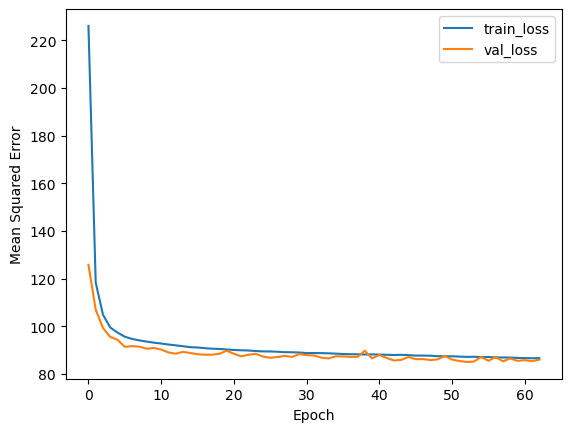

In [15]:
# Plot the training and validation loss over epochs
plt.plot(history.history['loss'], label='train_loss')
plt.plot(history.history['val_loss'], label='val_loss')
plt.xlabel('Epoch')
plt.ylabel('Mean Squared Error')
plt.legend()
plt.show()

In [89]:
print(y_val)
print(val_predictions)

1905    31
6712    51
8483    41
8225    86
360     44
        ..
2697    62
6250    35
8015    52
2061    29
7502    66
Name: congestion, Length: 1698, dtype: int64
[[36.656036]
 [54.876865]
 [45.52919 ]
 ...
 [38.608383]
 [29.036917]
 [75.86718 ]]


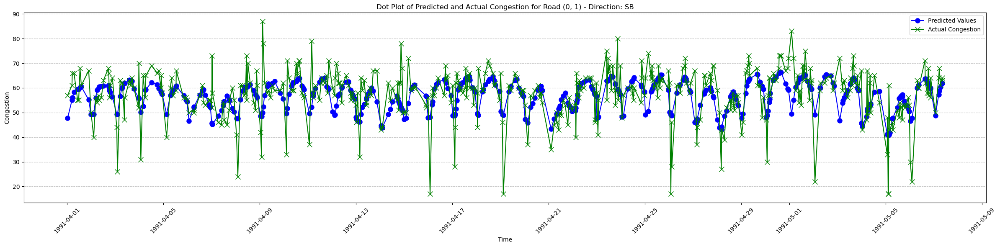

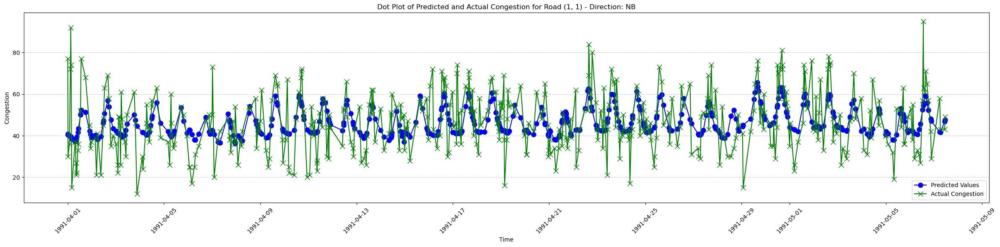

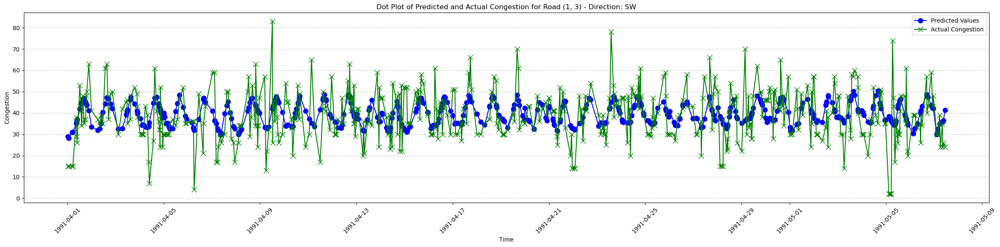

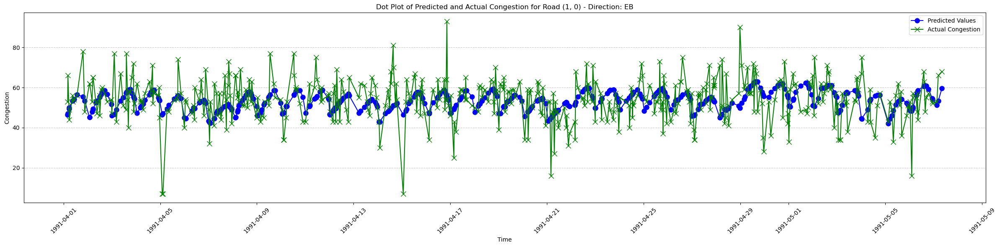

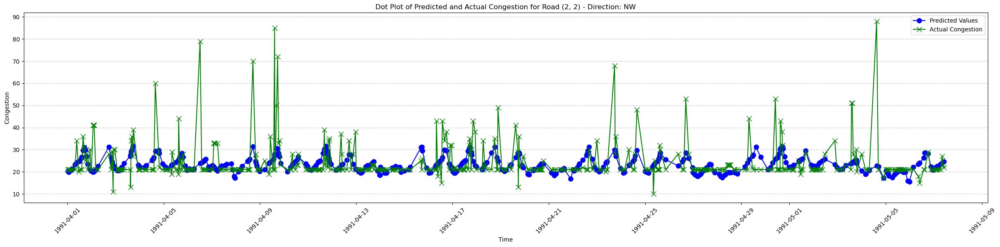

...

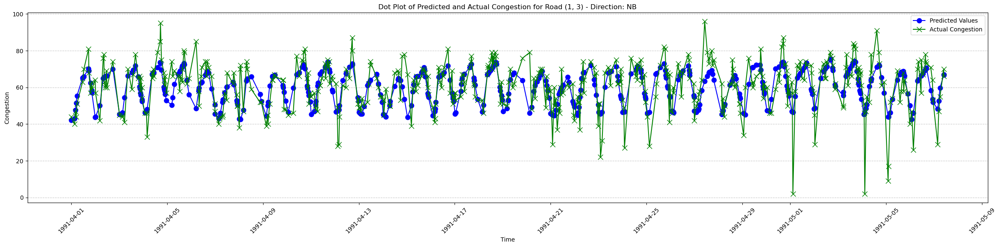

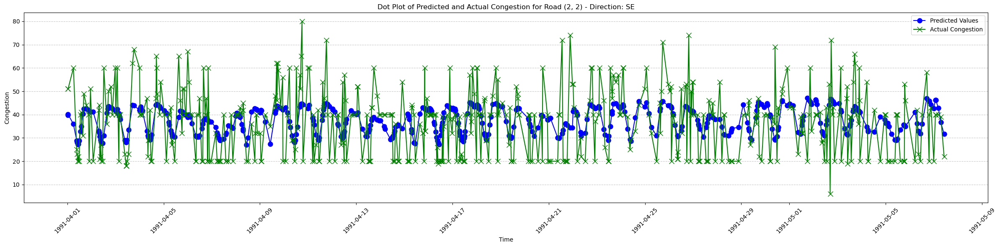

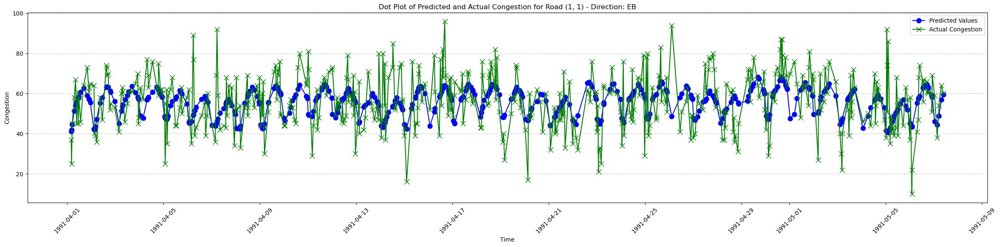

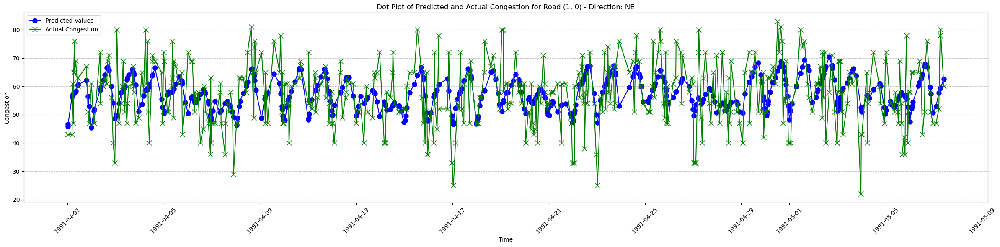

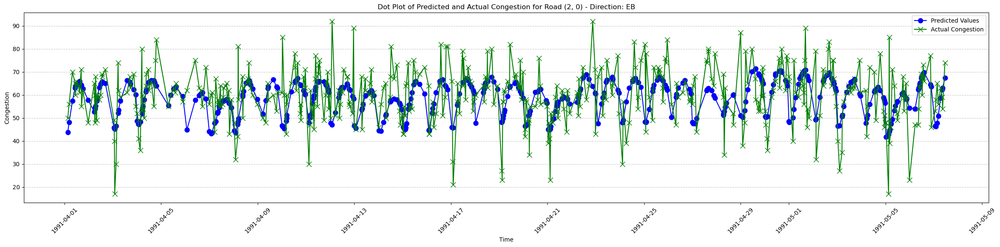

In [17]:
# Get the indices of the rows in X_val
val_indices = X_val.index

# Find the corresponding 'time', 'x', 'y', 'direction', and 'congestion' values for the rows in X_val
corresponding_data = train_df_1.loc[val_indices, ['time', 'x', 'y', 'direction', 'congestion']]

# Add the predicted values to the corresponding_data DataFrame
corresponding_data['predicted_values'] = val_predictions

# Get unique combinations of roads and directions
unique_combinations = corresponding_data[['x', 'y', 'direction']].drop_duplicates()

# Iterate through unique combinations and create dot plots
for index, row in unique_combinations.iterrows():
    road_x = row['x']
    road_y = row['y']
    road_direction = row['direction']
    
    # Filter data based on the current road and direction
    filtered_rows = (corresponding_data['x'] == road_x) & (corresponding_data['y'] == road_y) & (corresponding_data['direction'] == road_direction)
    filtered_data = corresponding_data[filtered_rows]
    
    # Create a dot plot only if there are data points for this combination
    if len(filtered_data) > 0:
        
        sorted_data = filtered_data.sort_values(by='time')

        plt.figure(figsize=(24, 6))
        
        plt.plot(sorted_data['time'], sorted_data['predicted_values'], color='blue', label='Predicted Values', marker='o', linestyle='-', markersize=8)
        plt.plot(sorted_data['time'], sorted_data['congestion'], color='green', label='Actual Congestion', marker='x', linestyle='-', markersize=8)
        
        plt.title(f'Dot Plot of Predicted and Actual Congestion for Road ({road_x}, {road_y}) - Direction: {road_direction}')
        plt.xlabel('Time')
        plt.ylabel('Congestion')
        plt.xticks(rotation=45)  # Rotate x-axis labels for better readability
        plt.tight_layout()
        
        # Add grid
        plt.grid(True, axis='y', linestyle='--', alpha=0.7)
        
        plt.legend()
        plt.show()

## All the Data